# Homework 3

**Name:** -- Diana Zepeda Tatengo --

**e-mail:** -- diana.zepeda6085@alumnos.udg.mx --

# MODULES

In [3]:
# Load modules
import numpy as np
import matplotlib.pyplot as plt
import math

from scipy.stats import wrapcauchy
from scipy.stats import levy_stable
from scipy.stats import exponweib
from scipy.spatial import distance

import plotly.graph_objects as go
import pandas as pd

# CLASSES

In [5]:
################# http://www.pygame.org/wiki/2DVectorClass ##################
class Vec2d(object):
    """2d vector class, supports vector and scalar operators,
       and also provides a bunch of high level functions
       """
    __slots__ = ['x', 'y']

    def __init__(self, x_or_pair, y = None):
        if y == None:            
            self.x = x_or_pair[0]
            self.y = x_or_pair[1]
        else:
            self.x = x_or_pair
            self.y = y
            
    # Addition
    def __add__(self, other):
        if isinstance(other, Vec2d):
            return Vec2d(self.x + other.x, self.y + other.y)
        elif hasattr(other, "__getitem__"):
            return Vec2d(self.x + other[0], self.y + other[1])
        else:
            return Vec2d(self.x + other, self.y + other)

    # Subtraction
    def __sub__(self, other):
        if isinstance(other, Vec2d):
            return Vec2d(self.x - other.x, self.y - other.y)
        elif (hasattr(other, "__getitem__")):
            return Vec2d(self.x - other[0], self.y - other[1])
        else:
            return Vec2d(self.x - other, self.y - other)

    # Multiplication
    def __mul__(self, scalar):
        return Vec2d(self.x * scalar, self.y * scalar)
    
    # Vector length
    def get_length(self):
        return math.sqrt(self.x**2 + self.y**2)
    
    # rotate vector
    def rotated(self, angle):        
        cos = math.cos(angle)
        sin = math.sin(angle)
        x = self.x*cos - self.y*sin
        y = self.x*sin + self.y*cos
        return Vec2d(x, y)

# FUNCTIONS

In [53]:
#############################
# Brownian motion trajectoy #
#############################
def bm_2d(n_steps=1000, speed=5, s_pos=[0,0]):
    """
    Arguments:
        n_steps: int, number of steps in the simulation (default is 1000).
        speed: float, magnitude of the step in each iteration (default is 5).
        s_pos: list, initial position [x, y] (default is [0,0]).
    Returns:
        BM_2d_df: returns a 2D array with the positions at each step
    """
    # Init velocity vector
    velocity = Vec2d(speed,0)
    
    # Init DF
    BM_2d_df = pd.DataFrame(columns=['x_pos','y_pos'])    
    # Add initial position
    temp_df = pd.DataFrame([{'x_pos':s_pos[0], 'y_pos':s_pos[1]}])    
    BM_2d_df = pd.concat([BM_2d_df, temp_df], ignore_index=True)
    
    # Generate the trajectory
    for i in range(n_steps-1):        
        turn_angle = np.random.uniform(low=-np.pi, high=np.pi)
        velocity = velocity.rotated(turn_angle)
    
        temp_df = pd.DataFrame([{'x_pos':BM_2d_df.x_pos[i]+velocity.x, 'y_pos':BM_2d_df.y_pos[i]+velocity.y}])    
        BM_2d_df = pd.concat([BM_2d_df, temp_df], ignore_index=True)
        
    return BM_2d_df
####################################
# Correlated Random Walk trajectoy #
####################################
def CRW_2d(n_steps=1000, speed=5, s_pos=[0,0], CRW_exponent=0.5):
    """
    Arguments:
        n_steps: int, number of steps in the simulation (default is 1000).
        speed: float, magnitude of the step in each iteration (default is 5).
        s_pos: list, initial position [x, y] (default is [0,0]).
        CRW_exponent: float, alpha value to get the turn_angle from cauchy (default is 0.5)
    Returns:
        CRW_2d: returns a 2D array with the positions at each step
    """
    # Init velocity vector
    velocity = Vec2d(speed,0)
    
    # Init DF
    CRW_2d = pd.DataFrame(columns=['x_pos','y_pos'])
    
    # Add initial position
    temp_df = pd.DataFrame([{'x_pos':s_pos[0], 'y_pos':s_pos[1]}])
    
    CRW_2d = pd.concat([CRW_2d, temp_df], ignore_index=True)
    
    # Generate the trajectory
    for i in range(n_steps-1):   
        turn_angle = wrapcauchy.rvs(CRW_exponent) # rvs gets random values from the distribution
        velocity = velocity.rotated(turn_angle)
    
        temp_df = pd.DataFrame([{'x_pos':CRW_2d.x_pos[i]+velocity.x, 'y_pos':CRW_2d.y_pos[i]+velocity.y}])    
        CRW_2d = pd.concat([CRW_2d, temp_df], ignore_index=True)
        
    return CRW_2d

#############################
# Mean Squared Displacement #
#############################
def msd(trajectory):
    """
    Compute the Mean Squared Displacement (MSD) for a given trajectory.
    
    Parameters:
    trajectory: An array of shape (N, d), where N is the number of time steps
                          and d is the number of spatial dimensions.
    
    Returns:
    msd: The MSD as a function of time.
    """
    N = len(trajectory)    
    msd = np.zeros(N-1)
    
    for i in range(1,N):
        displacements = trajectory[i:] - trajectory[:N - i]
        squared_displacements = np.sum(displacements**2, axis=1) # Square each coordinate of the displacement and add them together
        msd[i-1] = np.mean(squared_displacements) # Save the msd
    
    return msd

####################################
#  Get the angles between vectors  #
####################################
def trajectory_angles(trajectory):
    angles = []

    for i in range(1, len(trajectory) - 1):
        # Get Vectors
        V1 = np.array(trajectory.iloc[i] - trajectory.iloc[i - 1]) # v(i) - v(i-1)
        V2 = np.array(trajectory.iloc[i + 1] - trajectory.iloc[i]) # v(i+1) - v(i)  
        
        # Dot Product
        dot_product = np.dot(V1, V2)
        
        # Vector magnitudes
        norm_V1 = np.linalg.norm(V1)
        norm_V2 = np.linalg.norm(V2)
        
        # Avoid div by 0
        if norm_V1 == 0 or norm_V2 == 0:
            angles.append(0)
            continue
        
        # Calculate the angle     
        cos_theta = dot_product / (norm_V1 * norm_V2)
        
        V1_3D = np.array([V1[0], V1[1], 0], dtype=np.float64)
        V2_3D = np.array([V2[0], V2[1], 0], dtype=np.float64)
        
        cross_product = np.cross(V1_3D, V2_3D)[-1]
        # arctan2 to get angles on [-π, π]
        theta = np.arctan2(cross_product, np.dot(V1, V2))
        #theta = np.arccos(cos_theta)  # Cos -1  get angles on [0, 2π]
        
        angles.append(theta)  
    
    return pd.Series(angles)

# Activities
## 1. Path length - (BM1 vs BM2 vs CRW) 

In [9]:
n_steps = 1000

#Get the Random Walks
BM_2d_df_3 = bm_2d(n_steps, speed=3)
BM_2d_df_6 = bm_2d(n_steps, speed=6)
CRW_2d_df_5 = CRW_2d(n_steps, speed=5)
CRW_2d_df_6 = CRW_2d(n_steps, speed=6)

#Get the Euclidean Distance
dis_BM_3 = np.array([distance.euclidean(BM_2d_df_3.iloc[i-1], BM_2d_df_3.iloc[i]) for i in range(1, BM_2d_df_3.shape[0])])
dis_BM_6 = np.array([distance.euclidean(BM_2d_df_6.iloc[i-1], BM_2d_df_6.iloc[i]) for i in range(1, BM_2d_df_6.shape[0])])
dis_CRW_5 = np.array([distance.euclidean(CRW_2d_df_5.iloc[i-1], CRW_2d_df_5.iloc[i]) for i in range(1, CRW_2d_df_5.shape[0])])
dis_CRW_6 = np.array([distance.euclidean(CRW_2d_df_6.iloc[i-1], CRW_2d_df_6.iloc[i]) for i in range(1, CRW_2d_df_6.shape[0])])

#Get the Cumulative Sum of the stephs
pl_BM_3 = np.cumsum(dis_BM_3)
pl_BM_6 = np.cumsum(dis_BM_6)
pl_CRW_5 = np.cumsum(dis_CRW_5)
pl_CRW_6 = np.cumsum(dis_CRW_6)

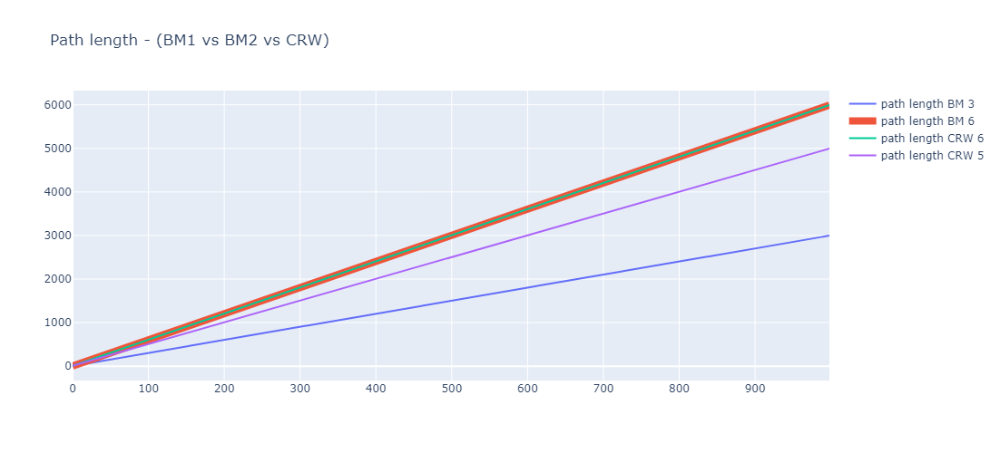

In [10]:
#Plot Results
fig = go.Figure()
fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = pl_BM_3,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length BM 3',
                               showlegend = True))
fig.add_trace(go.Scatter(x = BM_2d_df_6.index,
                               y = pl_BM_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 8),
                               mode = 'lines',
                               name = 'path length BM 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6.index,
                               y = pl_CRW_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length CRW 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_5.index,
                               y = pl_CRW_5,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'path length CRW 5',
                               showlegend = True))
fig.update_layout(title_text = 'Path length - (BM1 vs BM2 vs CRW)',
                        autosize = False,
                         width=900, 
                         height=500
)
fig.show()

## 2. Mean Squared Displacement - (BM vs CRW)

The Mean Squared Displacement (MSD) measures how far a particle moves on average after a time $ n $. It is obtained by averaging the squared displacements over all possible positions in the trajectory. 
It is given by:

$$
MSD(n) = \frac{1}{N - n} \sum_{i=1}^{N-n} (\vec{r}_{i+n} - \vec{r}_i)^2
$$

Donde:
- $ N $ es el número total de puntos en la trayectoria.
- $ n $ es el tiempo de retraso (*lag time*).
- $ \vec{r}_i $ the position of the particle in time $ i $.
- $ (\vec{r}_{i+n} - \vec{r}_i)^2 $ represents the quadratic distance between two positions separated by $ n $ steps.

The Mean Squared Displacement (MSD) is a statistical quantity, meaning that we are not only interested in the displacement of a single particle at a single instant but rather in the average of these displacements over time (or across multiple particles if more than one is present).

### 2.1  Given Trajectories

Calculation of the MSD and plotting the reference trajectories provided by Dr. Fernando to compare them with my generated trajectories.

In [80]:
# Given Trajectories
ref_BM_2d_df_3 = pd.read_csv('trajectories/brownian_3.csv')
ref_BM_2d_df_6 = pd.read_csv('trajectories/brownian_6.csv')
ref_CRW_2d_df_6_6 = pd.read_csv('trajectories/crw_6_6.csv')
ref_CRW_2d_df_6_9 = pd.read_csv('trajectories/crw_6_9.csv')

# Get the trajectory values
trajectory1 = ref_BM_2d_df_3[['x_pos', 'y_pos']].values
trajectory2 = ref_BM_2d_df_6[['x_pos', 'y_pos']].values
trajectory3 = ref_CRW_2d_df_6_6[['x_pos', 'y_pos']].values
trajectory4 = ref_CRW_2d_df_6_9[['x_pos', 'y_pos']].values

# Calcutate the MSD of the trajectories
msd_BM_3_ref = msd(trajectory1)
msd_BM_6_ref = msd(trajectory2)
msd_CRW_6_6_ref = msd(trajectory3)
msd_CRW_6_9_ref = msd(trajectory4)

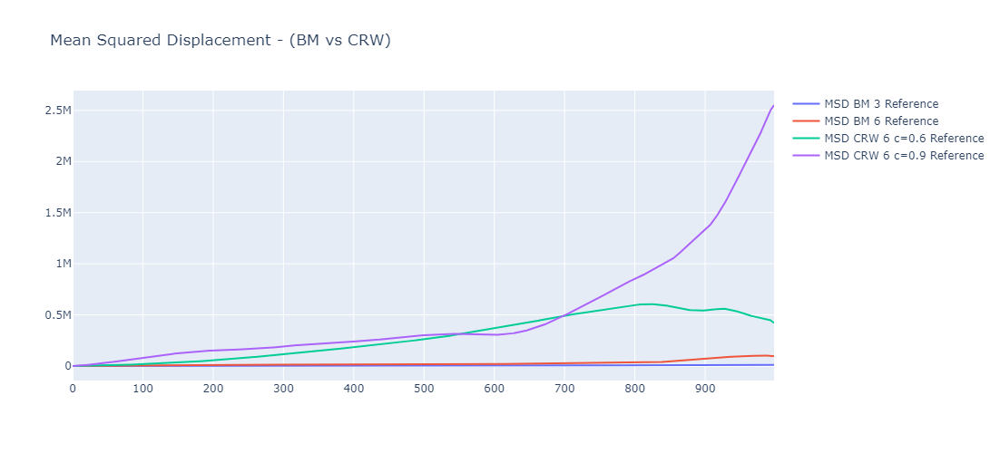

In [78]:
# Plot the results
fig = go.Figure()
fig.add_trace(go.Scatter(x = ref_BM_2d_df_3.index,
                               y = msd_BM_3_ref,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 3 Reference',
                               showlegend = True))
fig.add_trace(go.Scatter(x = ref_BM_2d_df_3.index,
                               y = msd_BM_6_ref,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 6 Reference',
                               showlegend = True))
fig.add_trace(go.Scatter(x = ref_CRW_2d_df_6_6.index,
                               y = msd_CRW_6_6_ref,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.6 Reference',
                               showlegend = True))
fig.add_trace(go.Scatter(x = ref_CRW_2d_df_6_9.index,
                               y = msd_CRW_6_9_ref,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.9 Reference',
                               showlegend = True))

fig.update_layout(title_text = 'Mean Squared Displacement - (BM vs CRW)',
                        autosize = False,
                         width=900, 
                         height=500
)
fig.show()

### 2.2 Generated Trajectories

Calculation of the MSD and plotting of my generated trajectories.

In [98]:
n_steps = 1000
s_pos = [0,0]
# Generate Trajectories
BM_2d_df_3 = bm_2d(n_steps, speed=3, s_pos=s_pos)
BM_2d_df_6 = bm_2d(n_steps, speed=6, s_pos=s_pos)
CRW_2d_df_6_6 = CRW_2d(n_steps, speed=6, s_pos=s_pos, CRW_exponent=0.6)
CRW_2d_df_6_9 = CRW_2d(n_steps, speed=6, s_pos=s_pos, CRW_exponent=0.9)

# Get the trajectory values
trajectory7 = BM_2d_df_3[['x_pos', 'y_pos']].values
trajectory8 = BM_2d_df_6[['x_pos', 'y_pos']].values
trajectory9 = CRW_2d_df_6_6[['x_pos', 'y_pos']].values
trajectory10 = CRW_2d_df_6_9[['x_pos', 'y_pos']].values

# Calcutate the MSD of the trajectories
msd_BM_3 = msd(trajectory7)
msd_BM_6 = msd(trajectory8)
msd_CRW_6_6 = msd(trajectory9)
msd_CRW_6_9 = msd(trajectory10)

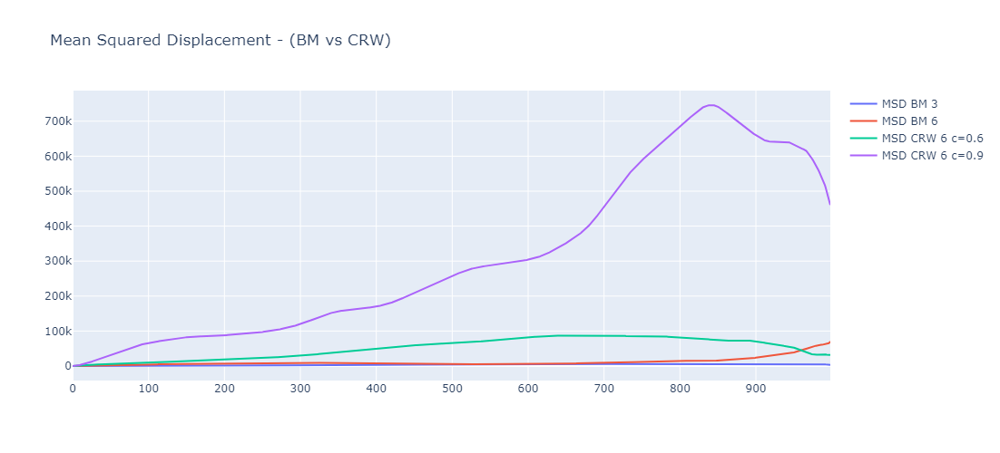

In [99]:
# Plot the results
fig = go.Figure()

fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = msd_BM_3,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 3',
                               showlegend = True))
fig.add_trace(go.Scatter(x = BM_2d_df_3.index,
                               y = msd_BM_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD BM 6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6_6.index,
                               y = msd_CRW_6_6,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.6',
                               showlegend = True))
fig.add_trace(go.Scatter(x = CRW_2d_df_6_9.index,
                               y = msd_CRW_6_9,                                                    
                               marker = dict(size=2),
                               line = dict(width = 2),
                               mode = 'lines',
                               name = 'MSD CRW 6 c=0.9',
                               showlegend = True))

fig.update_layout(title_text = 'Mean Squared Displacement - (BM vs CRW)',
                        autosize = False,
                         width=900, 
                         height=500
)
fig.show()

## 3. Turning-angle Distribution - (source dist. vs observed dist.)

## 3.1 Given Trajectory

In [18]:
crw_6_9_ref = pd.read_csv('trajectories/crw_6_9.csv')
crw_6_6_ref = pd.read_csv('trajectories/crw_6_6.csv')

# Calculate the angles
crw_6_9_ref['angle'] = trajectory_angles(crw_6_9_ref).shift(1)  # Shift para alinear con los puntos correctos
crw_6_6_ref['angle'] = trajectory_angles(crw_6_6_ref).shift(1)

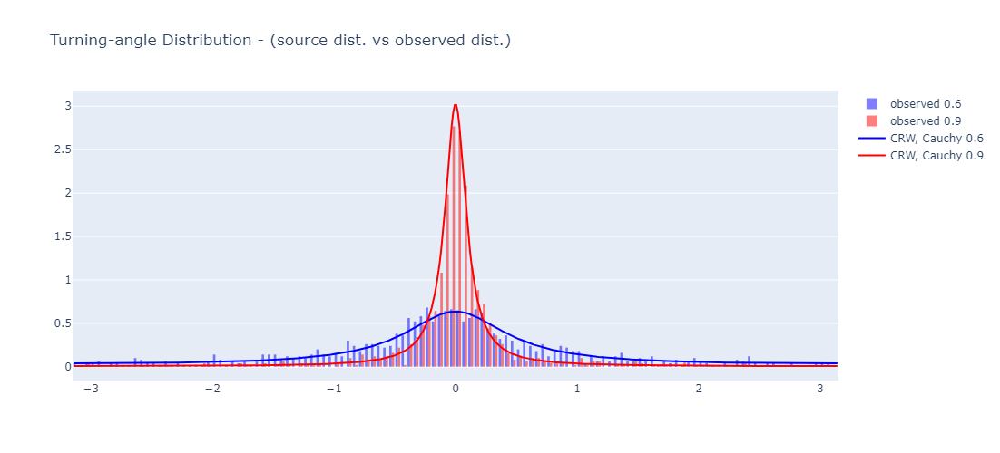

In [19]:
resolution = 500
aux_domain = np.linspace(-np.pi, np.pi, resolution)

aux_domain_wrapped = np.mod(aux_domain, 2 * np.pi)
aux_domain_wrapped2 = np.mod(aux_domain, 2 * np.pi)

fig_wrapcauchy_pdf = go.Figure()
wrapcauchy_9_pdf = np.array([wrapcauchy.pdf(i,0.9) for i in aux_domain_wrapped])
wrapcauchy_6_pdf = np.array([wrapcauchy.pdf(i,0.6) for i in aux_domain_wrapped2])

fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_6_ref.angle.values, 
    nbinsx=150, 
    histnorm='probability density', 
    marker=dict(color='blue'),
    opacity=0.5,
    name="observed 0.6"
))
fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_9_ref.angle.values, 
    nbinsx=150, 
    histnorm='probability density',
    marker=dict(color='red'),
    opacity=0.5,
    name="observed 0.9"
))
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_6_pdf,
        marker = dict(size=2),
        line = dict(width=2, color='blue'),
        mode = 'lines',
        name=f'CRW, Cauchy 0.6',
        showlegend = True
    )
)
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_9_pdf,
        marker = dict(size=2),
        line = dict(width=2,  color='red'),
        mode = 'lines',            
        name=f'CRW, Cauchy 0.9',
        showlegend = True
    )
)

fig_wrapcauchy_pdf.update_layout(title_text = 'Turning-angle Distribution - (source dist. vs observed dist.) ',
                        autosize = False,
                         width=1000, 
                         height=500
)

fig_wrapcauchy_pdf.show()

## 3.2 Generated Trajectory

In [21]:
crw_6_9 = CRW_2d(n_steps, speed=6, s_pos=[2,5], CRW_exponent=0.9)
crw_6_6 = CRW_2d(n_steps, speed=6, s_pos=[2,5], CRW_exponent=0.6)

# Calculate the angles
crw_6_9['angle'] = trajectory_angles(crw_6_9).shift(1)  # Shift para alinear con los puntos correctos
crw_6_6['angle'] = trajectory_angles(crw_6_6).shift(1)

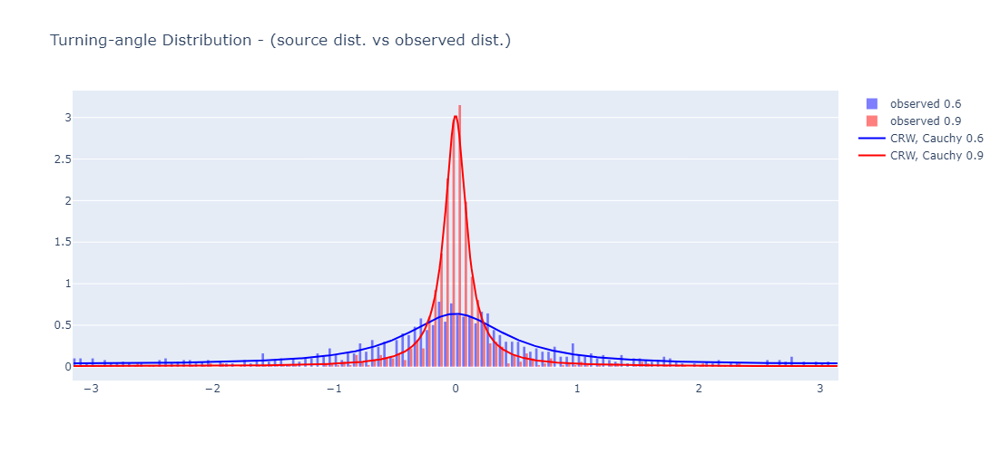

In [22]:
resolution = 500
aux_domain = np.linspace(-np.pi, np.pi, resolution)

aux_domain_wrapped = np.mod(aux_domain, 2 * np.pi)
aux_domain_wrapped2 = np.mod(aux_domain, 2 * np.pi)

fig_wrapcauchy_pdf = go.Figure()
wrapcauchy_9_pdf = np.array([wrapcauchy.pdf(i,0.9) for i in aux_domain_wrapped])
wrapcauchy_6_pdf = np.array([wrapcauchy.pdf(i,0.6) for i in aux_domain_wrapped2])

fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_6.angle.values, 
    nbinsx=150, 
    histnorm='probability density', 
    marker=dict(color='blue'),
    opacity=0.5,
    name="observed 0.6"
))
fig_wrapcauchy_pdf.add_trace(go.Histogram(
    x=crw_6_9.angle.values, 
    nbinsx=150, 
    histnorm='probability density',
    marker=dict(color='red'),
    opacity=0.5,
    name="observed 0.9"
))
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_6_pdf,
        marker = dict(size=2),
        line = dict(width=2, color='blue'),
        mode = 'lines',
        name=f'CRW, Cauchy 0.6',
        showlegend = True
    )
)
fig_wrapcauchy_pdf.add_trace(
    go.Scatter(
        x = aux_domain,
        y = wrapcauchy_9_pdf,
        marker = dict(size=2),
        line = dict(width=2,  color='red'),
        mode = 'lines',            
        name=f'CRW, Cauchy 0.9',
        showlegend = True
    )
)

fig_wrapcauchy_pdf.update_layout(title_text = 'Turning-angle Distribution - (source dist. vs observed dist.) ',
                        autosize = False,
                         width=1000, 
                         height=500
)

fig_wrapcauchy_pdf.show()

## 4. Step-length Distribution - (source dist. vs observed dist.)

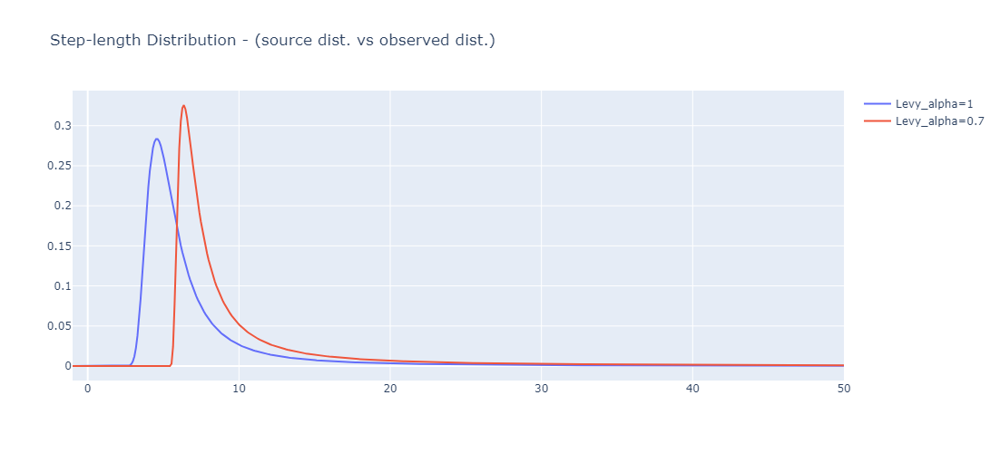

In [24]:
# Initial Parameters
m = 5
beta = 1
alphas = [0.1, 0.5, 1, 1.9] # Diferent values for alpha
resolution = 500
x = np.linspace(-1, 50, resolution)

fig_levy_pdf = go.Figure()

# Adding all the curves
fig_levy_pdf.add_trace(go.Scatter(
    x=x, 
    y=levy_stable.pdf(x, 1, beta, loc=m),
    mode='lines', 
    name="Levy_alpha=1"))

fig_levy_pdf.add_trace(go.Scatter(
    x=x, 
    y=levy_stable.pdf(x, 0.7, beta, loc=m),
    mode='lines', 
    name="Levy_alpha=0.7"))

fig_levy_pdf.update_layout(
    title=" Step-length Distribution - (source dist. vs observed dist.) ",
    width=800, 
    height=500,
    xaxis=dict(dtick=10), # Marks every 10 on X   
)

fig_levy_pdf.show()